Wholesale customers là dataset phục vụ cho bài toán customer segmentation dựa vào một số thông tin và hành vi của khách hàng 
- Đọc dữ liệu
- Trực quan hóa dữ liệu
- Chuẩn hóa dữ liệu 
- Dùng elbow method để chọn ra số clusters thích hợp (có thể chọn số clusters $\pm1$ để so sánh sự khác biệt)
- Biểu diễn các cụm sang không gian 2 chiều và 3 chiều
- Chọn ra một số data samples theo từng cụm để phân tích các giá trị trong đó 

1. Analyze and Preprocess data - Check if the dataset has missing values or has any other problem.
2. Feature Engineering
3. Determine the cluster number
    3. a. Use elbow method as baseline
    3. b. Apply other methods to compare with elbow
4. Use Pipeline
    4. a. Use scaler and dimensional reduction (if it is necessary).
    4. b. Use suitable clustering model for this problem. 
5. Visualize your cluster in 2D or 3D to compare the result.
6. Measure performance of your clustering model.
7. Conclusion and Discussion (<= 200 words, also input your opinion or conclusion here)


How can I measure your point:
1. Your function is callable and runs correctly
2. The performance of your model (in full pipeline) is acceptable. The final error based on my train and test set is low enough.
3. The data preprocessing is correct or make sense
4. The Feature engineering is correct or make sense
5. Any other additional process will be considered a small plus point.

# Load Dataset

In [114]:
%matplotlib inline
import numpy as np 
import pandas as pd 
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, PowerTransformer, RobustScaler, normalize
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans, AgglomerativeClustering
import scipy.cluster.hierarchy as shc
import warnings
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.pipeline import make_pipeline   

In [2]:
df = pd.read_csv("Clustered_Customer_Data.csv")

In [8]:
df.head()

,Unnamed: 0,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,2
2,2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,3
3,3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,0
4,4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   BALANCE                           8950 non-null   float64
 1   BALANCE_FREQUENCY                 8950 non-null   float64
 2   PURCHASES                         8950 non-null   float64
 3   ONEOFF_PURCHASES                  8950 non-null   float64
 4   INSTALLMENTS_PURCHASES            8950 non-null   float64
 5   CASH_ADVANCE                      8950 non-null   float64
 6   PURCHASES_FREQUENCY               8950 non-null   float64
 7   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 8   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 9   CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 10  CASH_ADVANCE_TRX                  8950 non-null   int64  
 11  PURCHASES_TRX                     8950 non-null   int64  
 12  CREDIT

In [11]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
BALANCE,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
BALANCE_FREQUENCY,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
ONEOFF_PURCHASES,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
INSTALLMENTS_PURCHASES,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
CASH_ADVANCE,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.21176
PURCHASES_FREQUENCY,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.00000
ONEOFF_PURCHASES_FREQUENCY,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.00000
CASH_ADVANCE_FREQUENCY,8950.0,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.50000


# Data Analysis

In [12]:
df.isna().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
Cluster                             0
dtype: int64

In [13]:
ProfileReport(df, title='Credit Card Dataset Report')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

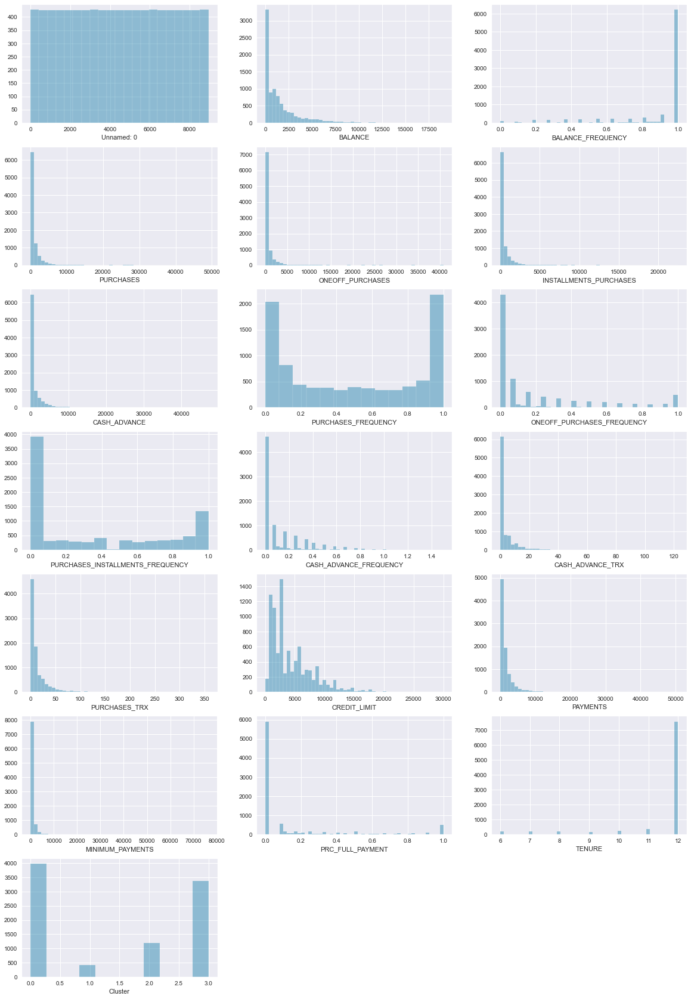

In [5]:
warnings.filterwarnings("ignore")
#sns.set_style("darkgr")
fig = plt.figure(figsize = (20,30))

plot_feat = df.columns

for i, v in enumerate(plot_feat):
    axes = fig.add_subplot(7, 3, i+1)
    sns.distplot(df[v], kde = False, ax = axes)

Có thể thấy được có khá nhiều cột có giá trị 0 và biểu đồ phân bố giá trị bị lệch về một phía.

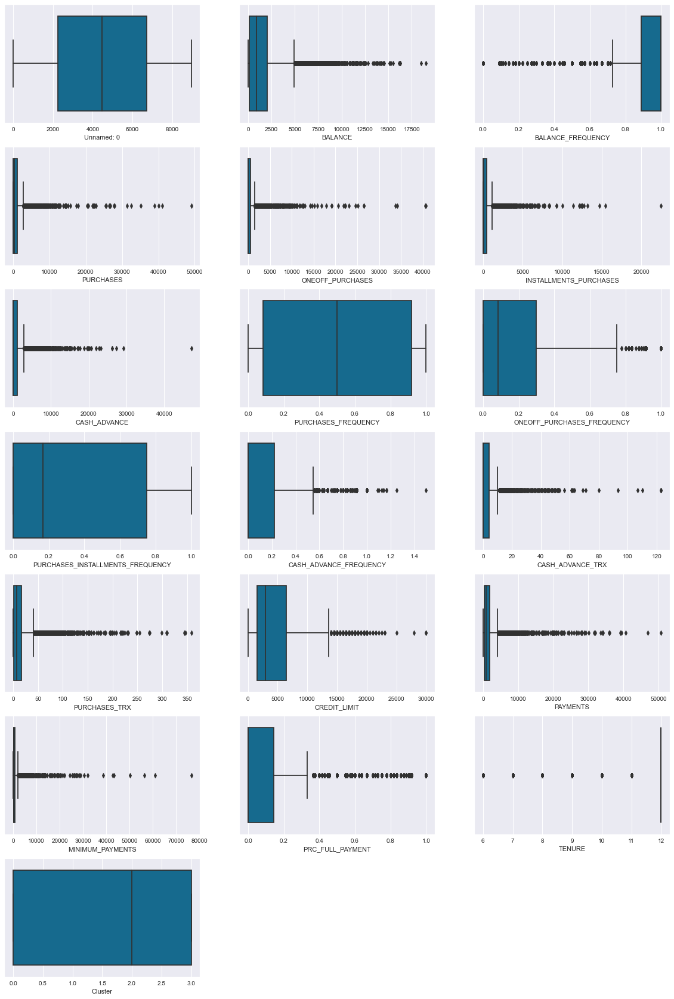

In [6]:
# Set up figure
fig = plt.figure(figsize = (20,30))

for i, v in enumerate(plot_feat):
    axes = fig.add_subplot(7, 3, i+1)
    sns.boxplot(x = df[v], ax = axes)

# Data Preprocessing

In [243]:
data = df.copy()

In [244]:
data = data.drop("Unnamed: 0", axis = 1)
data.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,2
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,3
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0


In [245]:
data = data.iloc[:,0:17]
scale = StandardScaler() #skewness
rs = RobustScaler() # outliers
trans = PowerTransformer()
#data_scaled = scale.fit_transform(data)
#data_scaled = normalize(data_scaled)
data_scaled = trans.fit_transform(data.values)
data_scaled = rs.fit_transform(data_scaled)

In [246]:
temp = pd.DataFrame(data_scaled, columns = data.columns)

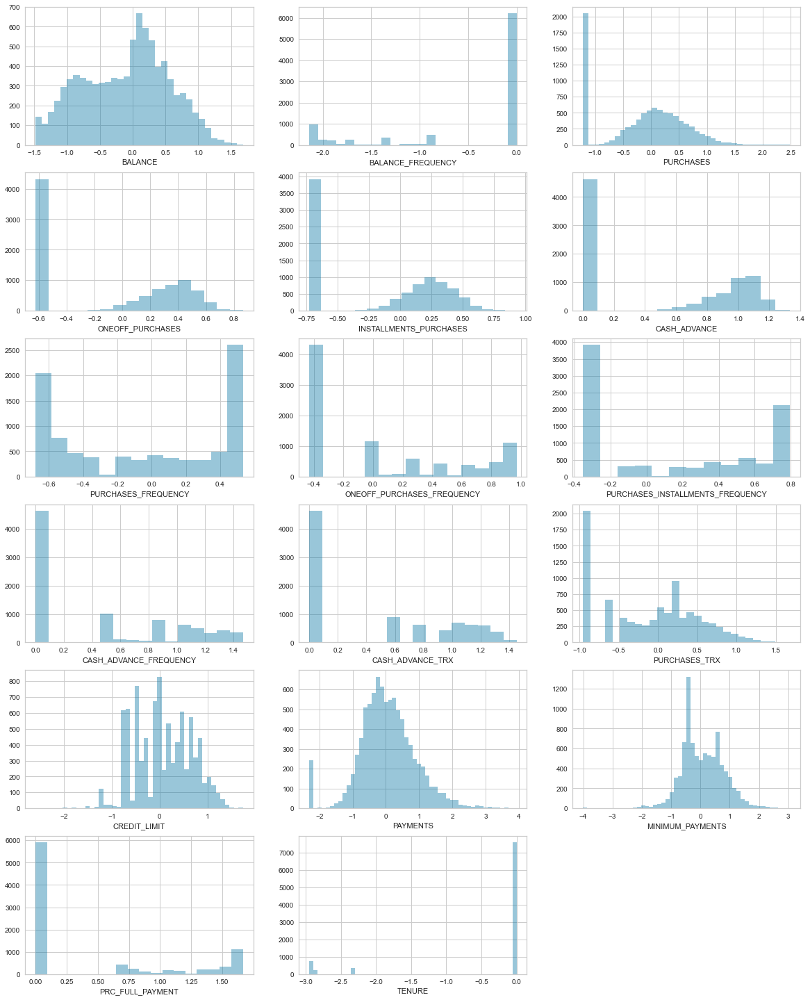

In [247]:
warnings.filterwarnings("ignore")
#sns.set_style("darkgr")
fig = plt.figure(figsize = (20,30))

plot_feat = temp.columns

for i, v in enumerate(plot_feat):
    axes = fig.add_subplot(7, 3, i+1)
    sns.distplot(temp[v], kde = False, ax = axes)

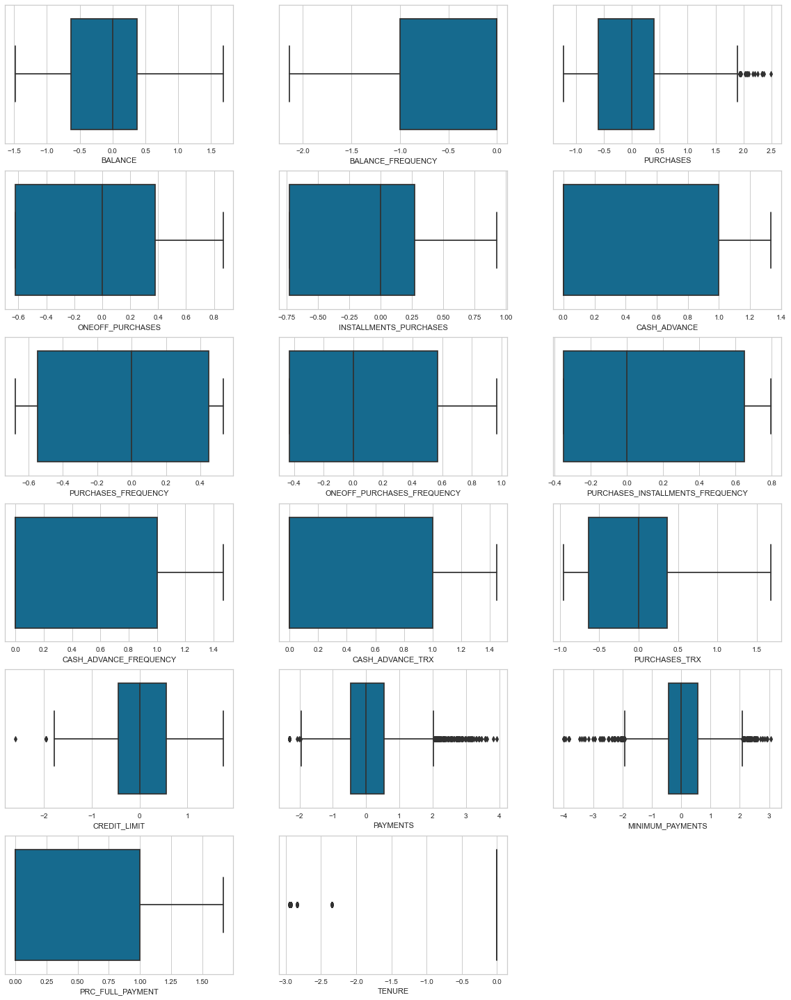

In [248]:
# Set up figure
fig = plt.figure(figsize = (20,30))

for i, v in enumerate(temp.columns):
    axes = fig.add_subplot(7, 3, i+1)
    sns.boxplot(x = temp[v], ax = axes)

# Model Part

## KMeans

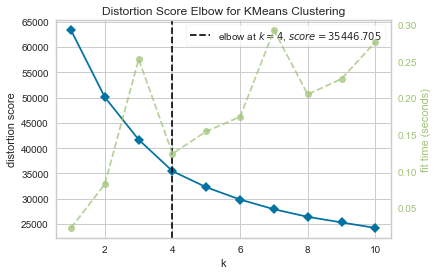

<AxesSubplot: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [249]:
warnings.filterwarnings("ignore")
elbow_method = KElbowVisualizer(KMeans(), k=(1,11))
elbow_method.fit(data_scaled)
elbow_method.show()

In [250]:
s_scores = []
for n in range(2 , 11):
    algorithm = KMeans(n_clusters=n)
    algorithm.fit(data_scaled)
    pred = algorithm.predict(data_scaled)
    silhouette_avg = silhouette_score(data_scaled, pred)
    s_scores.append(silhouette_avg) # data for the silhouette score method

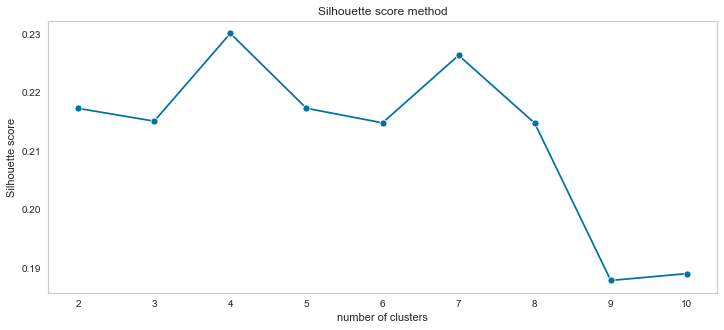

In [251]:
warnings.filterwarnings("ignore")
fig, ax = plt.subplots(figsize=(12,5))
ax = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax)
ax.set_title("Silhouette score method")
ax.set_xlabel("number of clusters")
ax.set_ylabel("Silhouette score")
plt.grid()
plt.show()

## Agglomerative Clustering 

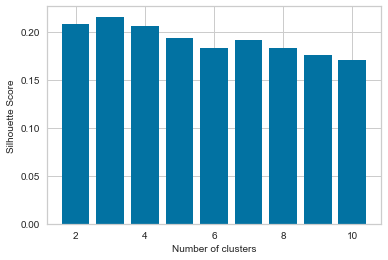

In [252]:
silhouette_scores = [] 

for n_cluster in range(2, 11):
    silhouette_scores.append( 
        silhouette_score(data_scaled, AgglomerativeClustering(n_clusters = n_cluster).fit_predict(data_scaled))) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5, 6,7,8,9,10] 
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show() 

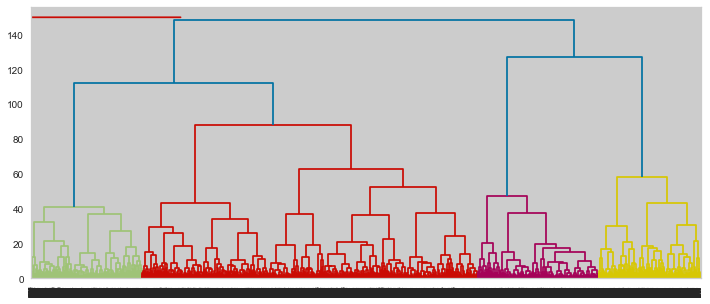

In [254]:
plt.figure(figsize = (12, 5))
dendo = shc.dendrogram(shc.linkage(data_scaled, method='ward'))
plt.plot([250]*20000, color='r')
plt.plot([150]*20000, color='r')
plt.show()

## Make Pipeline for clustering (PCA + KMeans)

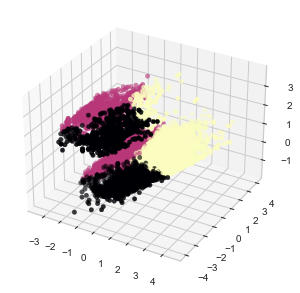

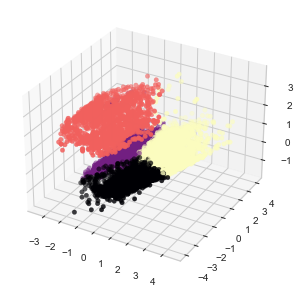

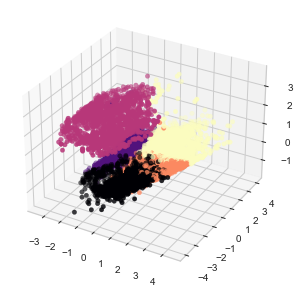

In [286]:
# PCA 3 component
pca_3 = PCA(n_components=3).fit(data_scaled)
pca_df3 = pd.DataFrame(pca_3.transform(data_scaled), columns=["pca_1", "pca_2", "pca_3"])
for i in range(3,6):
    kmeans_model = KMeans(n_clusters=i)
    kmeans_model.fit(data_scaled)
    pca_3 = PCA(n_components=3) #dùng pca 3 thành phần
    pca_3.fit(data_scaled)
    pca_df3 = pd.DataFrame(pca_3.transform(data_scaled), columns=["pca_1", "pca_2", "pca_3"])
    plt.figure(figsize=(12, 5))
    plt.subplot(1,3,i - 2)
    ax = plt.subplot(projection="3d")
    ax.scatter(pca_df3.pca_1, pca_df3.pca_2, pca_df3.pca_3, c=kmeans_model.labels_, cmap="magma")
    plt.show()

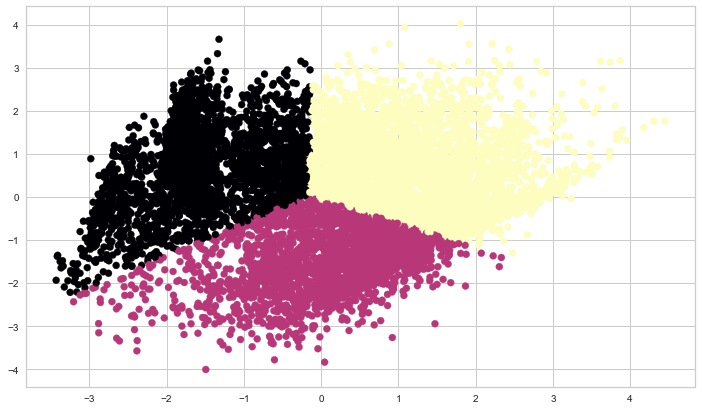

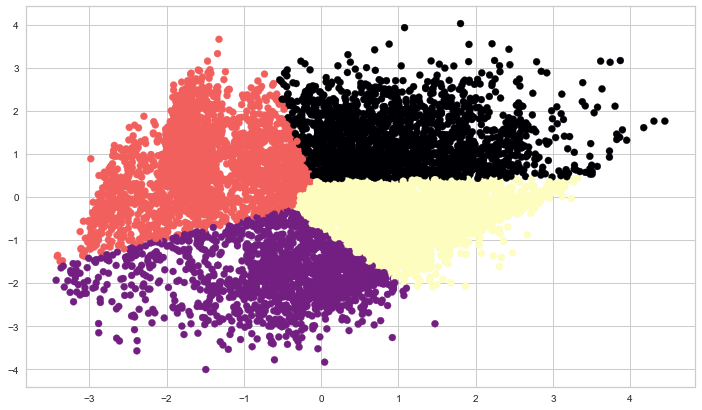

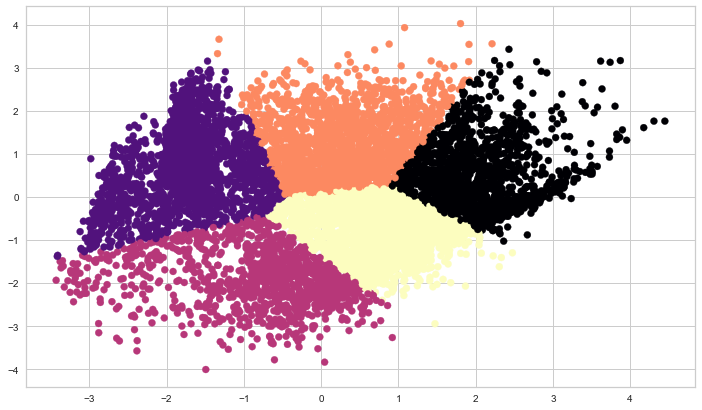

In [284]:
# PCA 2 component
pca_2 = PCA(n_components=2).fit(data_scaled)
pca_df2 = pd.DataFrame(pca_2.transform(data_scaled), columns=["pca_1", "pca_2"])
for i in range(3,6):
    kmeans_model = KMeans(n_clusters=i)
    kmeans_model.fit(data_scaled)
    pipeline = make_pipeline(pca_2, kmeans_model)
    # fit the model to the scaled dataset
    model_fit = pipeline.fit(data_scaled)
    plt.figure(figsize=(12, 7))
    ax = plt.subplot()
    ax.scatter(pca_df2.pca_1, pca_df2.pca_2, c=model_fit.predict(data_scaled), cmap="magma")
    plt.show()

## Save model

In [287]:
kmeans_model = KMeans(n_clusters=4)
kmeans_model.fit(data_scaled)

KMeans(n_clusters=4)

In [288]:
import pickle 
file_name = "model.sav" 
pickle.dump(kmeans_model, open(file_name, "wb"))

## Load model

In [289]:
file_name = "model.sav"
model = pickle.load(open(file_name, "rb"))

In [292]:
cluster = kmeans_model.labels_
cluster_0 = np.where(cluster==0)
cluster_1 = np.where(cluster==1)
cluster_2 = np.where(cluster==2)
cluster_3 = np.where(cluster==3)

In [293]:
data.iloc[cluster_0]

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
1,3202.467416,0.909091,0.0,0.0,0.0,6442.945483,0.000000,0.000000,0.0,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
4,817.714335,1.000000,16.0,16.0,0.0,0.000000,0.083333,0.083333,0.0,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
14,2772.772734,1.000000,0.0,0.0,0.0,346.811390,0.000000,0.000000,0.0,0.083333,1,0,3000.0,805.647974,989.962866,0.000000,12
24,5368.571219,1.000000,0.0,0.0,0.0,798.949863,0.000000,0.000000,0.0,0.363636,4,0,6000.0,1422.726707,1657.002877,0.000000,11
26,1615.967240,1.000000,102.0,102.0,0.0,244.840485,0.166667,0.166667,0.0,0.250000,5,2,1700.0,890.178845,971.183209,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8719,165.240633,0.181818,0.0,0.0,0.0,1088.751325,0.000000,0.000000,0.0,0.166667,4,0,1500.0,0.000000,864.206542,0.000000,12
8722,1056.267818,0.909091,0.0,0.0,0.0,1450.812947,0.000000,0.000000,0.0,0.166667,8,0,1500.0,1909.972695,415.089844,0.111111,12
8724,3002.791004,1.000000,2463.0,2463.0,0.0,797.158950,0.166667,0.166667,0.0,0.166667,3,3,3000.0,431.716492,16638.733850,0.000000,12
8729,2492.463204,1.000000,0.0,0.0,0.0,2625.644609,0.000000,0.000000,0.0,0.250000,7,0,3000.0,621.099464,1073.237454,0.000000,12


# Discussion & Conclusion

In [294]:
print("Em đã dùng Power Transformation và Robust Scaler để tiến hình chuyển đổi dữ liệu, vì dữ liệu ban đầu bị skewness và có khá nhiều outlier. Ở đây ta còn có thể dùng log transformation cho các feature bị skewness.")

Em đã dùng Power Transformation và Robust Scaler để tiến hình chuyển đổi dữ liệu, vì dữ liệu ban đầu bị skewness và có khá nhiều outlier. Ở đây ta còn có thể dùng log transformation cho các feature bị skewness.
